### EDA

In [432]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, RocCurveDisplay
import xgboost as xgb
from xgboost import XGBClassifier
from xgboost import XGBRegressor
from xgboost import plot_tree
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import random

pd.set_option('display.max_columns', 100)


### Loadng in our datasets

In [433]:
# the encoding parameter will help us with the french characters
listings = pd.read_csv('../data/Airbnb Data/Listings.csv', encoding='ISO-8859-1')
reviews = pd.read_csv('../data/Airbnb Data/Reviews.csv', encoding='ISO-8859-1')
bronx = pd.read_csv('../data/bronx.csv')
brooklyn = pd.read_csv('../data/brooklyn.csv')
manhattan = pd.read_csv('../data/manhatten.csv')
paris = pd.read_csv('../data/paris.csv')
queens = pd.read_csv('../data/queens.csv')
staten_island = pd.read_csv('../data/staten_island.csv')

C:\Users\jmgar\AppData\Local\Temp\ipykernel_34288\2741878362.py:2: DtypeWarning:

Columns (5,13) have mixed types. Specify dtype option on import or set low_memory=False.



In [434]:
listings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 279712 entries, 0 to 279711
Data columns (total 33 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   listing_id                   279712 non-null  int64  
 1   name                         279539 non-null  object 
 2   host_id                      279712 non-null  int64  
 3   host_since                   279547 non-null  object 
 4   host_location                278872 non-null  object 
 5   host_response_time           150930 non-null  object 
 6   host_response_rate           150930 non-null  float64
 7   host_acceptance_rate         166625 non-null  float64
 8   host_is_superhost            279547 non-null  object 
 9   host_total_listings_count    279547 non-null  float64
 10  host_has_profile_pic         279547 non-null  object 
 11  host_identity_verified       279547 non-null  object 
 12  neighbourhood                279712 non-null  object 
 13 

### Filtering by just New York and Paris

In [435]:
listings = listings[listings['city'].isin(['New York', 'Paris'])]
listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101702 entries, 0 to 279711
Data columns (total 33 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   listing_id                   101702 non-null  int64  
 1   name                         101626 non-null  object 
 2   host_id                      101702 non-null  int64  
 3   host_since                   101651 non-null  object 
 4   host_location                101418 non-null  object 
 5   host_response_time           41851 non-null   object 
 6   host_response_rate           41851 non-null   float64
 7   host_acceptance_rate         54298 non-null   float64
 8   host_is_superhost            101651 non-null  object 
 9   host_total_listings_count    101651 non-null  float64
 10  host_has_profile_pic         101651 non-null  object 
 11  host_identity_verified       101651 non-null  object 
 12  neighbourhood                101702 non-null  object 
 13 

In [436]:
listings.head()

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,host_has_profile_pic,host_identity_verified,neighbourhood,district,city,latitude,longitude,property_type,room_type,accommodates,bedrooms,amenities,price,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,f,Buttes-Montmartre,NaN,Paris,48.88668,2.33343,Entire apartment,Entire place,2,1.0,"[""Heating"", ""Kitchen"", ""Washer"", ""Wifi"", ""Long...",53,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
1,3705183,39 mÃÂ² Paris (Sacre CÃ âur),10328771,2013-11-29,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Buttes-Montmartre,NaN,Paris,48.88617,2.34515,Entire apartment,Entire place,2,1.0,"[""Shampoo"", ""Heating"", ""Kitchen"", ""Essentials""...",120,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
2,4082273,"Lovely apartment with Terrace, 60m2",19252768,2014-07-31,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,f,Elysee,NaN,Paris,48.88112,2.31712,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Washer"", ""Wifi"",...",89,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
3,4797344,Cosy studio (close to Eiffel tower),10668311,2013-12-17,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,t,Vaugirard,NaN,Paris,48.84571,2.30584,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Wifi"", ""Long ter...",58,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,24837558,2014-12-14,"Paris, Ile-de-France, France",NaN,NaN,NaN,f,1.0,t,f,Passy,NaN,Paris,48.85500,2.26979,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Essentials"", ""Ha...",60,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f


### Identifying null or irrelevant columns

In [437]:
#  the majority of host_response_time, host_response_rate, and host_acceptance_rate are null
# 
listings.isnull().sum(axis=0)

listing_id                         0
name                              76
host_id                            0
host_since                        51
host_location                    284
host_response_time             59851
host_response_rate             59851
host_acceptance_rate           47404
host_is_superhost                 51
host_total_listings_count         51
host_has_profile_pic              51
host_identity_verified            51
neighbourhood                      0
district                       64690
city                               0
latitude                           0
longitude                          0
property_type                      0
room_type                          0
accommodates                       0
bedrooms                       17012
amenities                          0
price                              0
minimum_nights                     0
maximum_nights                     0
review_scores_rating           26889
review_scores_accuracy         26960
r

In [438]:
# The 64k null districts are our paris listings
# Although the district column is mostly null, I will not drop this column because it has our borough info
listings.district.value_counts()

Manhattan        16553
Brooklyn         14474
Queens            4704
Bronx              992
Staten Island      289
Name: district, dtype: int64

In [439]:
# since most hosts have a profile pic, this will not be worth keeping
listings.host_has_profile_pic.value_counts()

t    101315
f       336
Name: host_has_profile_pic, dtype: int64

In [440]:
# Checking to see if this column had a good spread of t and f, which it does
listings.host_identity_verified.value_counts()

t    79391
f    22260
Name: host_identity_verified, dtype: int64

In [441]:
# Checking to see if this column had a good spread of t and f, which it does
listings.instant_bookable.value_counts()

f    70039
t    31663
Name: instant_bookable, dtype: int64

### Dropping null or irrelevant columns

In [442]:
listings = listings.drop(columns=['host_response_time', 'host_response_rate', 'host_acceptance_rate', 'host_has_profile_pic'])
listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101702 entries, 0 to 279711
Data columns (total 29 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   listing_id                   101702 non-null  int64  
 1   name                         101626 non-null  object 
 2   host_id                      101702 non-null  int64  
 3   host_since                   101651 non-null  object 
 4   host_location                101418 non-null  object 
 5   host_is_superhost            101651 non-null  object 
 6   host_total_listings_count    101651 non-null  float64
 7   host_identity_verified       101651 non-null  object 
 8   neighbourhood                101702 non-null  object 
 9   district                     37012 non-null   object 
 10  city                         101702 non-null  object 
 11  latitude                     101702 non-null  float64
 12  longitude                    101702 non-null  float64
 13 

### Diving deeper into the price column

In [443]:
# it appears that there is an outlier for price around 12000
# it is also interesting that there are listings with a price of 0
listings['price'].describe()

count    101702.000000
mean        123.921712
std         239.002984
min           0.000000
25%          60.000000
50%          85.000000
75%         130.000000
max       12000.000000
Name: price, dtype: float64

In [444]:
listings['price'].value_counts()

60      4033
50      4020
100     3883
80      3828
70      3792
        ... 
1257       1
1195       1
2650       1
814        1
3300       1
Name: price, Length: 958, dtype: int64

In [445]:
# starting with the 75%, checking how many prices are above a certain number
# from this, it looks like these are reasonable outliers that should not be dropped
print(f">130: {listings.loc[listings['price']>130, ['price']].count()}")
print(f">250: {listings.loc[listings['price']>250, ['price']].count()}")
print(f">500: {listings.loc[listings['price']>500, ['price']].count()}")
print(f">1000: {listings.loc[listings['price']>1000, ['price']].count()}")
print(f">5000: {listings.loc[listings['price']>5000, ['price']].count()}")

>130: price    25082
dtype: int64
>250: price    6907
dtype: int64
>500: price    1648
dtype: int64
>1000: price    428
dtype: int64
>5000: price    46
dtype: int64


In [446]:
# there are 90 listings with a price of 0, this does not seem correct to me
print(f"=0: {listings.loc[listings['price']==0, ['price']].count()}")

=0: price    90
dtype: int64


In [447]:
# from the head, it looks like these are hotel room listings
free = listings.loc[listings['price']==0]
free.head()

,listing_id,name,host_id,host_since,host_location,host_is_superhost,host_total_listings_count,host_identity_verified,neighbourhood,district,city,latitude,longitude,property_type,room_type,accommodates,bedrooms,amenities,price,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
98209,44312919,Bienvenue ÃÂ l'HÃÂ´tel des 3 CollÃÂ¨ges,357400186,2020-07-20,FR,f,0.0,t,Pantheon,NaN,Paris,48.84802,2.34234,Room in boutique hotel,Hotel room,0,NaN,"[""Free wifi"", ""Building staff"", ""Complimentary...",0,1,1125,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f
202022,42830099,Hotel Hugo,300800542,2019-10-07,"New York, New York, United States",f,9.0,t,SoHo,Manhattan,New York,40.72638,-74.00885,Room in boutique hotel,Hotel room,0,NaN,"[""Keurig coffee machine"", ""Pack \u2019n Play/t...",0,30,365,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f
202023,43247472,Hotel 57,324955773,2020-01-06,"New York, New York, United States",f,4.0,t,Midtown,Manhattan,New York,40.76085,-73.96938,Room in boutique hotel,Hotel room,0,NaN,"[""Air conditioning"", ""Coffee maker"", ""Concierg...",0,30,365,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f
203253,43205598,Wellington Hotel,335389657,2020-02-11,"New York, New York, United States",f,0.0,t,Midtown,Manhattan,New York,40.76448,-73.98055,Room in boutique hotel,Hotel room,0,NaN,"[""Self-parking \u2014 $45/day"", ""Hot breakfast...",0,1,365,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f
203254,44567521,"The Standard, East Village",360662584,2020-08-05,US,f,0.0,f,East Village,Manhattan,New York,40.72743,-73.99136,Room in boutique hotel,Hotel room,0,NaN,"[""HDTV"", "" linens"", ""Dedicated workspace"", ""He...",0,1,365,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f


In [448]:
free['room_type'].value_counts()

Hotel room    90
Name: room_type, dtype: int64

In [449]:
free['property_type'].value_counts()

Room in boutique hotel    60
Room in hotel             29
Room in hostel             1
Name: property_type, dtype: int64

In [450]:
# it appears that not all hotel rooms are listed at a price of 0, just these few
# perhaps these listings take you to the hotel's site to find the price
# regardless, I will keep these 90 listings in for now
listings['room_type'].value_counts()

Entire place    74775
Private room    24122
Hotel room       1695
Shared room      1110
Name: room_type, dtype: int64

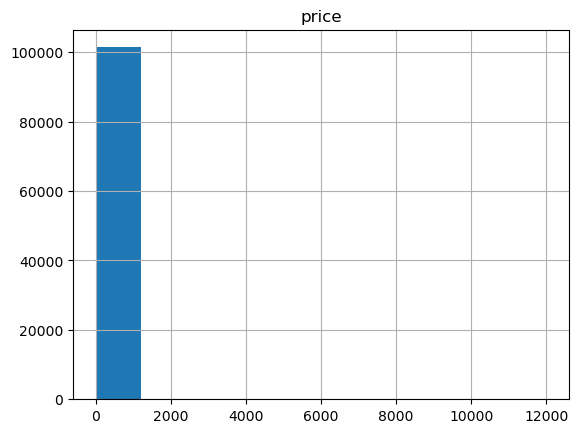

In [451]:
# with our outliers, we won't see a great histogram
listings.hist('price');

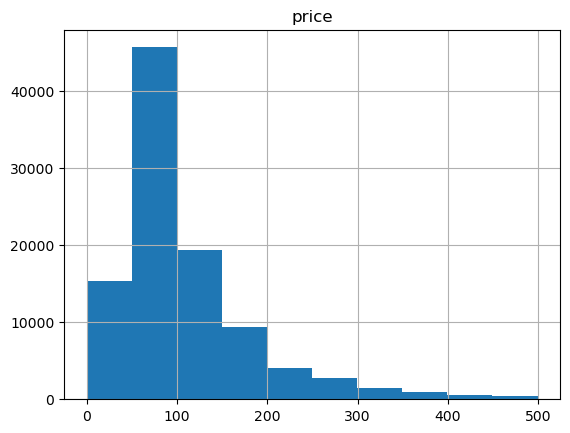

In [452]:
# lets try setting a max of 500, which will drop 1648 rows, or 1.6% of our data
listings.loc[listings['price']<500].hist('price');

### An issue with looking at the price, is that the price is listed in the local currency. Let's try to add a column with for USD and Euro

In [453]:
# splitting the ny and paris listings
ny_listings = listings[listings['city'].isin(['New York'])]
paris_listings = listings[listings['city'].isin(['Paris'])]

In [454]:
# the price for ny is already in usd, so i just need to copy this column
# to create the euro column, i will use the current exchange rate
ny_listings['price_usd'] = ny_listings['price']
ny_listings['price_euro'] = ny_listings['price'] * .9141
ny_listings[['price', 'price_usd', 'price_euro']].head()

C:\Users\jmgar\AppData\Local\Temp\ipykernel_34288\1177917605.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\jmgar\AppData\Local\Temp\ipykernel_34288\1177917605.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,price,price_usd,price_euro
9220,110,110,100.5510
9221,99,99,90.4959
9222,220,220,201.1020
9223,215,215,196.5315
9224,300,300,274.2300


In [455]:
# same set up for the paris listings
paris_listings['price_euro'] = paris_listings['price']
paris_listings['price_usd'] = paris_listings['price'] * 1.0938
paris_listings[['price','price_euro','price_usd']].head()

C:\Users\jmgar\AppData\Local\Temp\ipykernel_34288\411441925.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\jmgar\AppData\Local\Temp\ipykernel_34288\411441925.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,price,price_euro,price_usd
0,53,53,57.9714
1,120,120,131.2560
2,89,89,97.3482
3,58,58,63.4404
4,60,60,65.6280


In [456]:
# Now that we have the columns set up, lets concat the tables back together
listings = pd.concat([paris_listings, ny_listings])
listings.head()

,listing_id,name,host_id,host_since,host_location,host_is_superhost,host_total_listings_count,host_identity_verified,neighbourhood,district,city,latitude,longitude,property_type,room_type,accommodates,bedrooms,amenities,price,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,price_euro,price_usd
0,281420,"Beautiful Flat in le Village Montmartre, Paris",1466919,2011-12-03,"Paris, Ile-de-France, France",f,1.0,f,Buttes-Montmartre,NaN,Paris,48.88668,2.33343,Entire apartment,Entire place,2,1.0,"[""Heating"", ""Kitchen"", ""Washer"", ""Wifi"", ""Long...",53,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,53.0,57.9714
1,3705183,39 mÃÂ² Paris (Sacre CÃ âur),10328771,2013-11-29,"Paris, Ile-de-France, France",f,1.0,t,Buttes-Montmartre,NaN,Paris,48.88617,2.34515,Entire apartment,Entire place,2,1.0,"[""Shampoo"", ""Heating"", ""Kitchen"", ""Essentials""...",120,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,120.0,131.2560
2,4082273,"Lovely apartment with Terrace, 60m2",19252768,2014-07-31,"Paris, Ile-de-France, France",f,1.0,f,Elysee,NaN,Paris,48.88112,2.31712,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Washer"", ""Wifi"",...",89,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,89.0,97.3482
3,4797344,Cosy studio (close to Eiffel tower),10668311,2013-12-17,"Paris, Ile-de-France, France",f,1.0,t,Vaugirard,NaN,Paris,48.84571,2.30584,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Wifi"", ""Long ter...",58,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,58.0,63.4404
4,4823489,Close to Eiffel Tower - Beautiful flat : 2 rooms,24837558,2014-12-14,"Paris, Ile-de-France, France",f,1.0,f,Passy,NaN,Paris,48.85500,2.26979,Entire apartment,Entire place,2,1.0,"[""Heating"", ""TV"", ""Kitchen"", ""Essentials"", ""Ha...",60,2,1125,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f,60.0,65.6280


### Lets look at that same histogram for USD and Euro

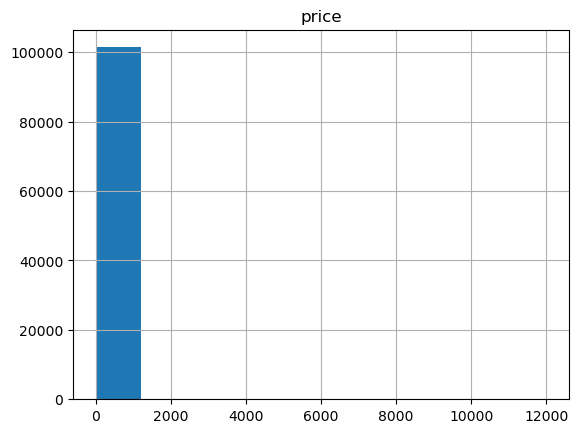

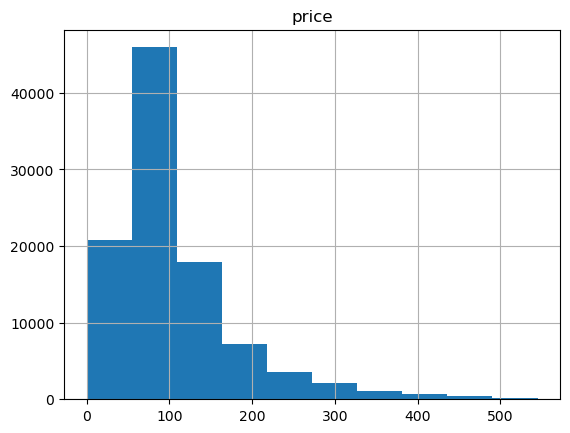

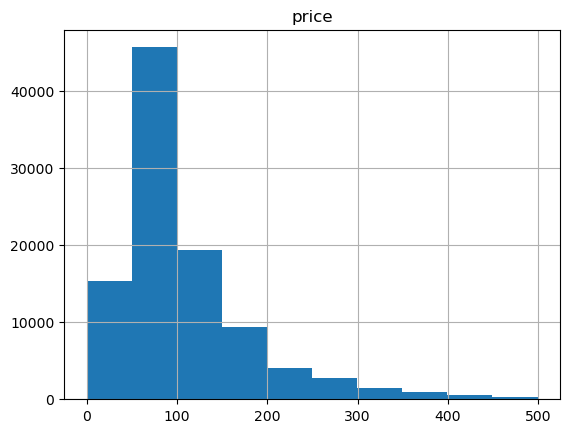

In [457]:
# not too different, but this is more accurate
listings.hist('price');
listings.loc[listings['price_euro']<500].hist('price');
listings.loc[listings['price_usd']<500].hist('price');

### Review score vs Price

In [458]:
listings_overall = listings.loc[listings['review_scores_rating'].notnull()]
listings_overall_500 = listings_overall.loc[listings_overall['price_usd']<500]
fig = px.scatter(x=listings_overall_500['review_scores_rating'],
                 y=listings_overall_500['price_usd'],
                 labels={'x':'Reviews - Overall','y':'Price USD'},
                 trendline='ols')
fig.show()

In [459]:
listings_cleanliness = listings.loc[listings['review_scores_cleanliness'].notnull()]
listings_cleanliness_500 = listings_cleanliness.loc[listings_cleanliness['price_usd']<500]
fig = px.scatter(x=listings_cleanliness_500['review_scores_cleanliness'],
                 y=listings_cleanliness_500['price_usd'],
                 labels={'x':'Reviews - Cleanliness','y':'Price USD'},
                 trendline='ols')
fig.show()

In [460]:
paris_overall = paris_listings.loc[paris_listings['review_scores_rating'].notnull()]
paris_overall_500 = paris_overall.loc[paris_overall['price_usd']<500]

ny_overall = ny_listings.loc[ny_listings['review_scores_rating'].notnull()]
ny_overall_500 = ny_overall.loc[ny_overall['price_usd']<500]

fig1 = px.scatter(x=ny_overall_500['review_scores_rating'],
                 y=ny_overall_500['price_usd'],
                 labels={'x':'Reviews - Overall','y':'Price USD'},
                 trendline='ols',
                 opacity = .2,
                 ).update_traces(marker=dict(color='red'))

fig2 = px.scatter(x=paris_overall_500['review_scores_rating'],
                  y=paris_overall_500['price_usd'],
                  labels={'x':'Reviews - Overall','y':'Price USD'},
                  trendline='ols',
                  opacity = .2)

fig = go.Figure(data = fig1.data + fig2.data)
fig.show()

In [461]:
paris_cleanliness = paris_listings.loc[paris_listings['review_scores_rating'].notnull()]
paris_cleanliness_500 = paris_cleanliness.loc[paris_cleanliness['price_usd']<500]

ny_cleanliness = ny_listings.loc[ny_listings['review_scores_rating'].notnull()]
ny_cleanliness_500 = ny_cleanliness.loc[ny_cleanliness['price_usd']<500]

fig1 = px.scatter(x=ny_cleanliness_500['review_scores_cleanliness'],
                 y=ny_cleanliness_500['price_usd'],
                 labels={'x':'Reviews - Cleanliness','y':'Price USD'},
                 trendline='ols',
                 opacity = .2
                 ).update_traces(marker=dict(color='red'))

fig2 = px.scatter(x=paris_cleanliness_500['review_scores_cleanliness'],
                  y=paris_cleanliness_500['price_usd'],
                  labels={'x':'Reviews - Cleanliness','y':'Price USD'},
                  trendline='ols',
                  opacity = .2)

fig = go.Figure(data = fig1.data + fig2.data)
fig.show()

### Exploring the Yelp Data

In [462]:
bronx.head()

,Unnamed: 0,id,alias,name,image_url,is_closed,url,review_count,categories,rating,transactions,phone,display_phone,distance,coordinates.latitude,coordinates.longitude,location.address1,location.address2,location.address3,location.city,location.zip_code,location.country,location.state,location.display_address,price,total,region,Restaurant or Attraction?
0,0,huCqalKTIWBv8w6fFsG49g,tobalá-the-bronx,Tobalá,https://s3-media4.fl.yelpcdn.com/bphoto/f2PBuC...,False,https://www.yelp.com/biz/tobal%C3%A1-the-bronx...,27,"[{'alias': 'mexican', 'title': 'Mexican'}, {'a...",4.5,[],1.347428e+10,(347) 427-6889,919.057006,40.887485,-73.906870,3732 Riverdale Ave,NaN,NaN,The Bronx,10463,US,NY,"['3732 Riverdale Ave', 'The Bronx, NY 10463']",NaN,2200,"{'center': {'longitude': -73.90588760375977, '...",Restaurant
1,1,I1AqEw-O6spamgtJLNPjBg,leche-y-miel-restaurant-bronx,Leche Y Miel Restaurant,https://s3-media2.fl.yelpcdn.com/bphoto/hVTUIn...,False,https://www.yelp.com/biz/leche-y-miel-restaura...,333,"[{'alias': 'comfortfood', 'title': 'Comfort Fo...",4.5,"['delivery', 'pickup']",1.718709e+10,(718) 708-5787,606.044667,40.883730,-73.901830,5761 Broadway,NaN,NaN,Bronx,10463,US,NY,"['5761 Broadway', 'Bronx, NY 10463']",$$,2200,"{'center': {'longitude': -73.90588760375977, '...",Restaurant
2,2,b6jOwyX4iaagw8YjXqq1sA,antonios-trattoria-bronx,Antonio's Trattoria,https://s3-media3.fl.yelpcdn.com/bphoto/2JkIBH...,False,https://www.yelp.com/biz/antonios-trattoria-br...,1027,"[{'alias': 'italian', 'title': 'Italian'}, {'a...",4.5,"['delivery', 'pickup']",1.718734e+10,(718) 733-6630,3230.153638,40.854131,-73.886601,2370 Belmont Ave,NaN,NaN,Bronx,10458,US,NY,"['2370 Belmont Ave', 'Bronx, NY 10458']",$$,2200,"{'center': {'longitude': -73.90588760375977, '...",Restaurant
3,3,O3PC6d2gRdiU9vyybATNZw,home-bx-steakhouse-bronx-2,Home Bx Steakhouse,https://s3-media4.fl.yelpcdn.com/bphoto/N6Ah_R...,False,https://www.yelp.com/biz/home-bx-steakhouse-br...,42,"[{'alias': 'steak', 'title': 'Steakhouses'}, {...",4.0,"['delivery', 'restaurant_reservation', 'pickup']",1.929243e+10,(929) 243-3527,790.460000,40.884740,-73.899910,224 W 238th St,NaN,NaN,Bronx,10463,US,NY,"['224 W 238th St', 'Bronx, NY 10463']",NaN,2200,"{'center': {'longitude': -73.90588760375977, '...",Restaurant
4,4,YllbMI89Czj6rrN-XMdUNw,yukka-latin-bistro-bronx-2,Yukka Latin Bistro,https://s3-media4.fl.yelpcdn.com/bphoto/HbhO7T...,False,https://www.yelp.com/biz/yukka-latin-bistro-br...,217,"[{'alias': 'latin', 'title': 'Latin American'}...",4.0,"['delivery', 'pickup']",1.347347e+10,(347) 346-9338,3030.814243,40.906445,-73.903875,5684 Riverdale Ave,NaN,NaN,Bronx,10471,US,NY,"['5684 Riverdale Ave', 'Bronx, NY 10471']",$$,2200,"{'center': {'longitude': -73.90588760375977, '...",Restaurant


In [463]:
print(f"bronx: {bronx['Restaurant or Attraction?'].value_counts()}")

print(f"brooklyn: {brooklyn['Restaurant or Attraction?'].value_counts()}")

print(f"manhattan: {manhattan['Restaurant or Attraction?'].value_counts()}")

print(f"queens: {queens['Restaurant or Attraction?'].value_counts()}")

print(f"staten island: {staten_island['Restaurant or Attraction?'].value_counts()}")

print(f"paris: {paris['Restaurant or Attraction?'].value_counts()}")

bronx: Restaurant    1250
Attraction    1198
Name: Restaurant or Attraction?, dtype: int64
brooklyn: Restaurant    1850
Attraction    1807
Name: Restaurant or Attraction?, dtype: int64
manhattan: Restaurant    2150
Attraction    2150
Name: Restaurant or Attraction?, dtype: int64
queens: Restaurant    3043
Attraction    3010
Name: Restaurant or Attraction?, dtype: int64
staten island: Restaurant    600
Attraction    600
Name: Restaurant or Attraction?, dtype: int64
paris: Restaurant    1050
Attraction    1050
Name: Restaurant or Attraction?, dtype: int64


In [464]:
# Creating new dataframes so we can look at the counts of the price category
bronx_price = bronx['price'].value_counts().rename_axis('price').reset_index(name='counts')
brooklyn_price = brooklyn['price'].value_counts().rename_axis('price').reset_index(name='counts')
manhattan_price = manhattan['price'].value_counts().rename_axis('price').reset_index(name='counts')
queens_price = queens['price'].value_counts().rename_axis('price').reset_index(name='counts')
staten_island_price = staten_island['price'].value_counts().rename_axis('price').reset_index(name='counts')
paris_price = paris['price'].value_counts().rename_axis('price').reset_index(name='counts')

In [465]:
# confirming that the euro symbol loaded in correctly
paris_price

,price,counts
0,€€,797
1,€€€,338
2,€,124
3,€€€€,40


In [466]:
# The 5 boroughs and Paris all appear to say a similar price distribution for their nearby yelp locations
fig = make_subplots(rows=3,cols=2)

fig.add_trace(go.Bar(x=bronx_price['price'],y=bronx_price['counts'],name='Bronx'), row=1, col=1)
fig.add_trace(go.Bar(x=brooklyn_price['price'],y=brooklyn_price['counts'],name='Brooklyn'), row=1, col=2)
fig.add_trace(go.Bar(x=manhattan_price['price'],y=manhattan_price['counts'],name='Manhattan'), row=2, col=1)
fig.add_trace(go.Bar(x=queens_price['price'],y=queens_price['counts'],name='Queens'), row=2, col=2)
fig.add_trace(go.Bar(x=staten_island_price['price'],y=staten_island_price['counts'],name='Staten Island'), row=3, col=1)
fig.add_trace(go.Bar(x=paris_price['price'],y=paris_price['counts'],name='Paris'), row=3, col=2)

fig.show()

In [467]:
# We set up the paris listings earlier in the notebook
bronx_listings = listings[listings['district'].isin(['Bronx'])]
brooklyn_listings = listings[listings['district'].isin(['Brooklyn'])]
manhattan_listings = listings[listings['district'].isin(['Manhattan'])]
queens_listings = listings[listings['district'].isin(['Queens'])]
staten_island_listings = listings[listings['district'].isin(['Staten Island'])]

In [468]:
# Comparing the average yelp review to the average airbnb review score
print(f"Bronx Yelp Review Mean: {bronx.rating.mean()} Bronx AirBnB Review Mean: {bronx_listings.review_scores_rating.mean()}")
print(f"Brooklyn Yelp Review Mean: {brooklyn.rating.mean()} Brooklyn AirBnB Review Mean: {brooklyn_listings.review_scores_rating.mean()}")
print(f"Manhattan Yelp Review Mean: {manhattan.rating.mean()} Manhattan AirBnB Review Mean: {manhattan_listings.review_scores_rating.mean()}")
print(f"Queens Yelp Review Mean: {queens.rating.mean()} Queens AirBnB Review Mean: {queens_listings.review_scores_rating.mean()}")
print(f"Staten Island Yelp Review Mean: {staten_island.rating.mean()} Staten Island AirBnB Review Mean: {staten_island_listings.review_scores_rating.mean()}")
print(f"Paris Yelp Review Mean: {paris.rating.mean()} Paris AirBnB Review Mean: {paris_listings.review_scores_rating.mean()}")

Bronx Yelp Review Mean: 4.183210784313726 Bronx AirBnB Review Mean: 93.67553191489361
Brooklyn Yelp Review Mean: 4.2631938747607325 Brooklyn AirBnB Review Mean: 94.49968004387969
Manhattan Yelp Review Mean: 4.266976744186047 Manhattan AirBnB Review Mean: 93.16788064940764
Queens Yelp Review Mean: 4.2202213778291755 Queens AirBnB Review Mean: 93.3808695652174
Staten Island Yelp Review Mean: 4.074583333333333 Staten Island AirBnB Review Mean: 94.67219917012449
Paris Yelp Review Mean: 4.253095238095238 Paris AirBnB Review Mean: 93.06393121825297


In [469]:
# This column will need to be seperated out, but I am having trouble with it
# I will look into this during the week, and talk to my group about it
bronx['categories'].value_counts()

[{'alias': 'theater', 'title': 'Performing Arts'}]                                                                                          72
[{'alias': 'festivals', 'title': 'Festivals'}]                                                                                              67
[{'alias': 'museums', 'title': 'Museums'}]                                                                                                  60
[{'alias': 'italian', 'title': 'Italian'}]                                                                                                  58
[{'alias': 'mexican', 'title': 'Mexican'}]                                                                                                  42
                                                                                                                                            ..
[{'alias': 'seafood', 'title': 'Seafood'}, {'alias': 'cocktailbars', 'title': 'Cocktail Bars'}]                                              1